In [1]:
import torch
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import DecisionNCE
import random
import sys
import torch.nn.functional as F
sys.path.append('/home/dodo/wgm/CL/BearRobot/')
sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/')
sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/data/')
sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/utils/')

from data.libero.data_process import demo2frames 
# from utils.dataset.dataloader import openimage
from PIL import Image
from torchvision import transforms

frame_length_dict = demo2frames.frame_counts_dict()


def load_model():
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model = DecisionNCE.load("DecisionNCE-T_libero_160ep", device=device)
    # model = DecisionNCE.load("DecisionNCE-T_epick", device=device)
    # model = DecisionNCE.load("DecisionNCE-T_openx_epic_libero_300ep", device=device)
    # model = DecisionNCE.load("DecisionNCE-T_openx_epic_libero_3W", device=device)
    # model = DecisionNCE.load("DecisionNCE-T_openx_epic", device=device)
    # model = DecisionNCE.load("DecisionNCE-P", device=device)
    # model = DecisionNCE.load("DecisionNCE-P", device=device)
    return model

model = load_model()

/home/dodo/miniconda3/envs/bear_clone/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


===========Currently, DecisionNCE only supports the RN50-CLIP model.    You are welcome to expand DecisionNCE to more and larger models.==============
========= Load Successfully ========


In [18]:
def cosine_similarity(X):
    dot_product = np.dot(X, X.T)
    norm = np.linalg.norm(X, axis=1)
    norm_product = np.outer(norm, norm)
    similarity = dot_product / norm_product
    return similarity

def euclidean_distance(X):
    squared_diff = np.sum((X[:, np.newaxis, :] - X[np.newaxis, :, :]) ** 2, axis=2)
    distance = np.sqrt(squared_diff)
    return distance


def correlation_matrix_map(features,type):
    correlation_matrix = cosine_similarity(features.cpu().numpy())
    print("mean:", correlation_matrix.mean())
    print("std:", correlation_matrix.std())
    if type == "Instruction":
        plt.figure(figsize=(10, 8))
        sns.heatmap(correlation_matrix, annot=True, fmt=".4f", cmap="YlGnBu", vmin=0, vmax=1)
        plt.title("Correlation Map of Different Language Instructions")
        plt.xlabel("Instructions")
        plt.ylabel("Instructions")
        plt.show()
    elif type == "Image":
        plt.figure(figsize=(10, 8))
        sns.heatmap(correlation_matrix, annot=True, fmt=".4f", cmap="YlGnBu", vmin=0, vmax=1)
        plt.title("Correlation Map of Images")
        plt.xlabel("Images")
        plt.ylabel("Images")
        plt.show()
    else:
        # mean = 
        # std = correlation_matrix.std()
        # correlation_matrix = (correlation_matrix - mean) / std
        plt.figure(figsize=(50, 20))
        sns.heatmap(correlation_matrix, annot=True, fmt=".5f", cmap="YlGnBu", vmin=0, vmax=1)
        plt.title("Correlation Map of Images")
        plt.xlabel("Images")
        plt.ylabel("Images")
        plt.show()

def get_img_of_instruction_list(Instruction_list):
    task_list = [instruction.replace(" ", "_")+ "_demo" for instruction in Instruction_list]
    demo_path_all = [random.choice(demo2frames.get_demos_for_task(task,frame_length_dict)) for task in task_list]
    begin_images = [Image.open(demo2frames.get_random_demo_img_path(demo_path,0,base_dir='/home/dodo/ljx/BearRobot/data/libero/dataset/')) for demo_path in demo_path_all]
    end_images = [Image.open(demo2frames.get_random_demo_img_path(demo_path,frame_length_dict[demo_path]-5,base_dir='/home/dodo/ljx/BearRobot/data/libero/dataset/')) for demo_path in demo_path_all]
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    begin_images_tensor = torch.cat([transform(image).unsqueeze(0).unsqueeze(0) for image in begin_images], dim=1).squeeze(0)
    end_images_tensor = torch.cat([transform(image).unsqueeze(0).unsqueeze(0) for image in end_images], dim=1).squeeze(0)
    return begin_images_tensor, end_images_tensor



mean: 0.19308542
std: 0.31076965


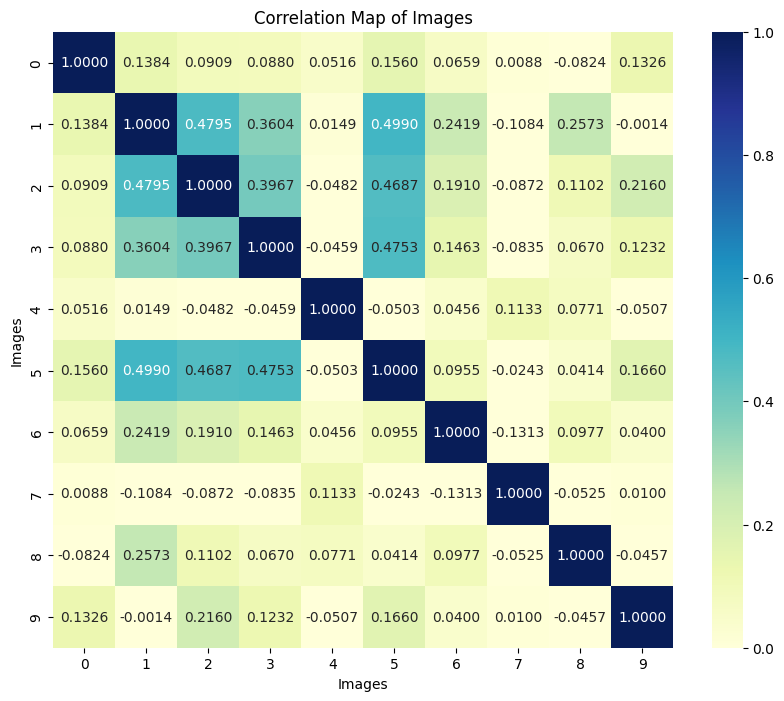

Img begin: tensor([[-0.0110,  0.0154, -0.0117,  ...,  0.0092,  0.0002,  0.0090],
        [-0.0096,  0.0133, -0.0121,  ...,  0.0092,  0.0008,  0.0103],
        [-0.0106,  0.0141, -0.0122,  ...,  0.0084,  0.0008,  0.0092],
        ...,
        [-0.0099,  0.0139, -0.0134,  ...,  0.0072,  0.0019,  0.0095],
        [-0.0111,  0.0161, -0.0109,  ...,  0.0081,  0.0002,  0.0111],
        [-0.0103,  0.0142, -0.0122,  ...,  0.0089,  0.0012,  0.0092]],
       device='cuda:0')


(tensor(0.6644, device='cuda:0'),
 tensor(-0.5703, device='cuda:0'),
 tensor(0.0002, device='cuda:0'),
 tensor(0.0312, device='cuda:0'))

In [17]:
    
Instruction_list = [
    "open the middle drawer of the cabinet",#0
    "turn on the stove", #1
    "put the bowl on the stove", #2
    "put the bowl on top of the cabinet",#3
    "put the wine bottle on the rack", #4
    "put the bowl on the plate",#5
    "open the top drawer and put the bowl inside", #6
    "put the cream cheese in the bowl",#7
    "put the wine bottle on top of the cabinet", #8
    "push the plate to the front of the stove", #9
]
begin, end = get_img_of_instruction_list(Instruction_list)
with torch.no_grad():
    text_features = model.encode_text(Instruction_list)
    img_feature_begin = model.encode_image(begin)
    img_feature_end = model.encode_image(end)
    # correlation_matrix_map(img_feature_begin,"Image")
    # correlation_matrix_map(img_feature_end,"Image")
    correlation_matrix_map(img_feature_end-img_feature_begin, "Image")
    # correlation_matrix_map(text_features,"Instruction")
# print("Text:", text_features)
print("Img begin:", img_feature_begin)
# print("Img end:", img_feature_end)
# print("Img diff:", img_feature_begin-img_feature_end)

a = (img_feature_begin - img_feature_end)
a.max(), a.min(), a.mean(), a.std()

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_middle_drawer_of_the_cabinet_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearR

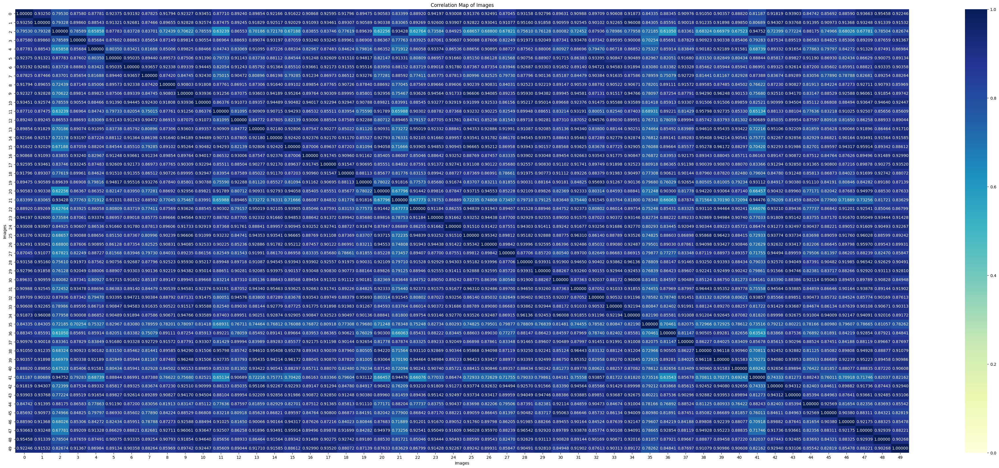

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/turn_on_the_stove_demo/demo_39/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dat

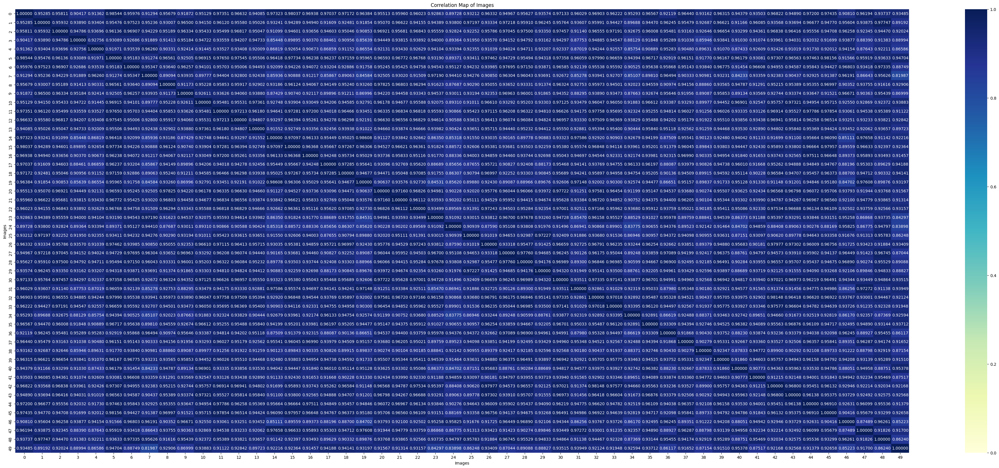

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_stove_demo/

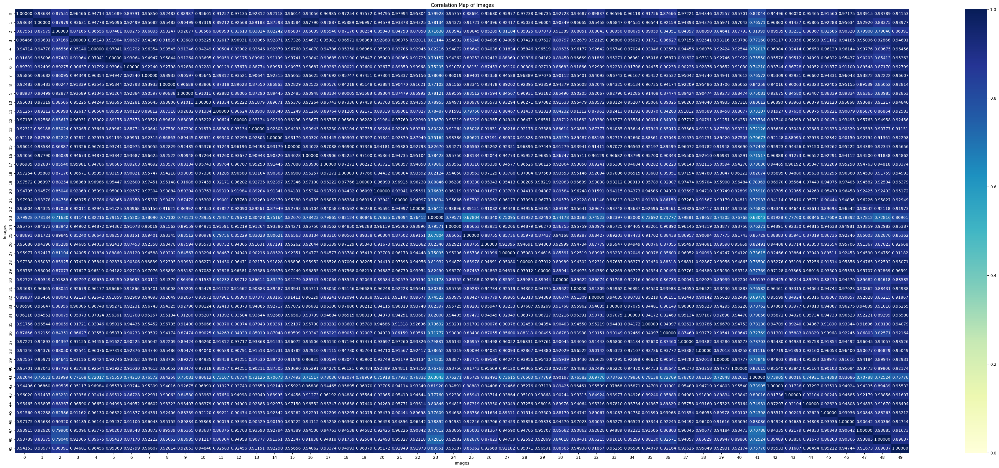

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_top_of_the_cabinet_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/data

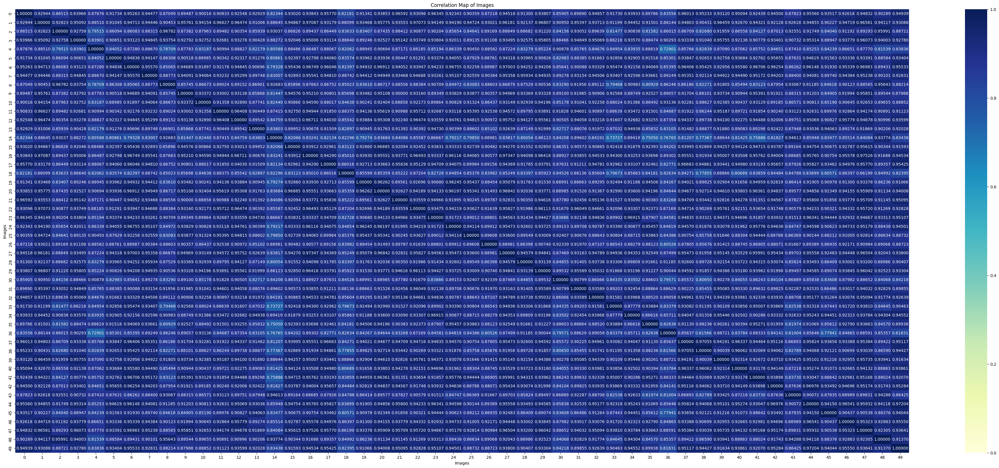

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_the_rack_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/l

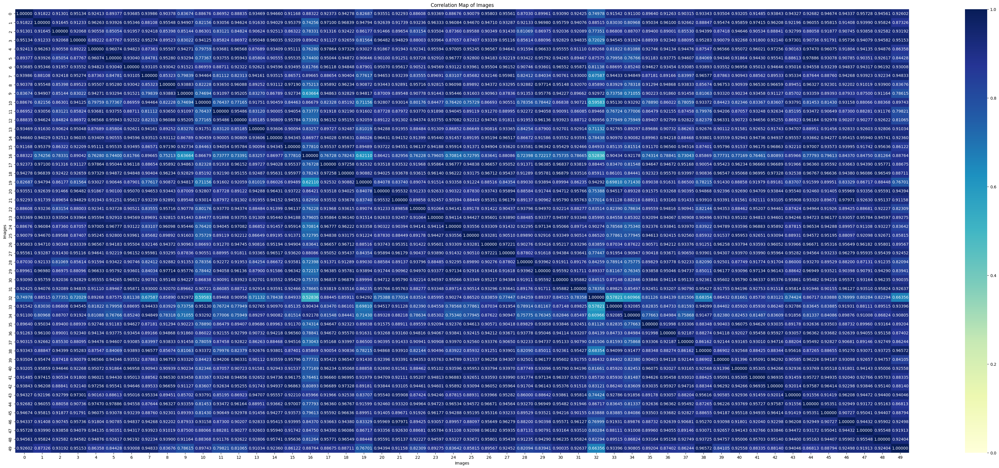

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/

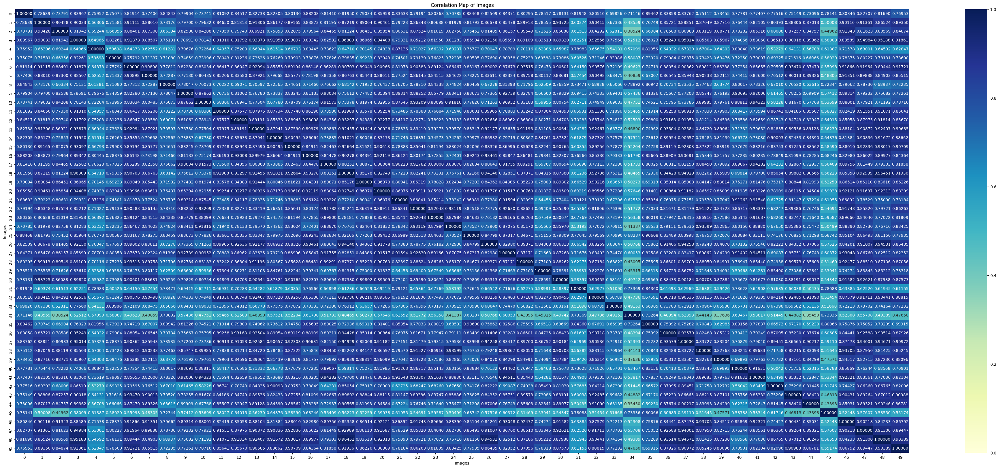

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/open_the_top_drawer_and_put_the_bowl_inside_demo/de

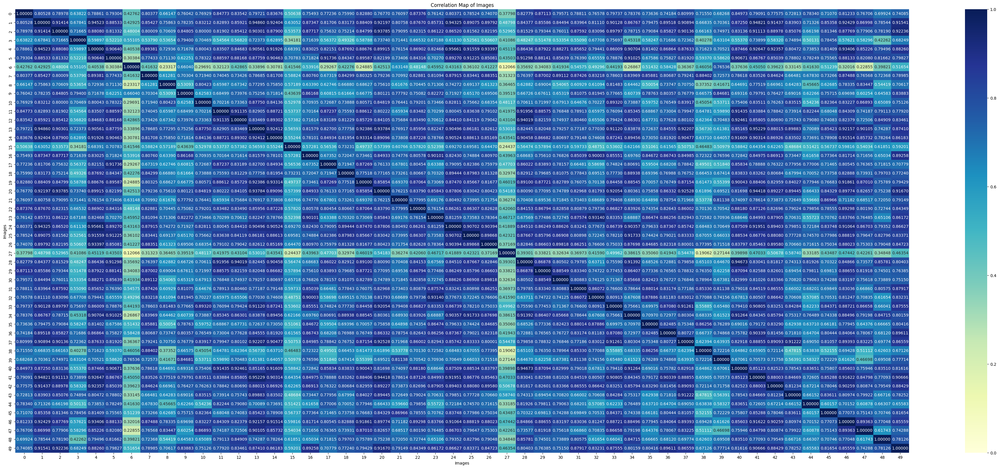

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_cream_cheese_in_the_bowl_demo/demo_47/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/dat

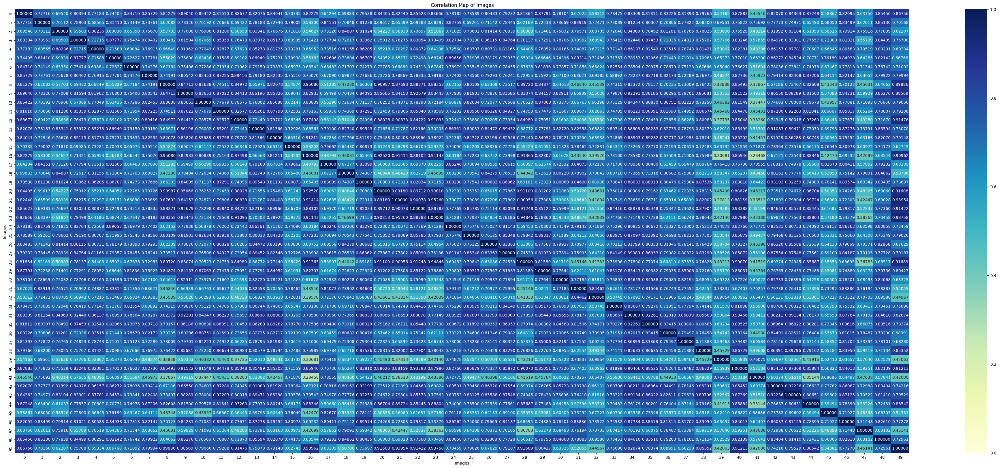

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/put_the_wine_bottle_on_top_of_the_cabinet_demo/demo_47/image0/0

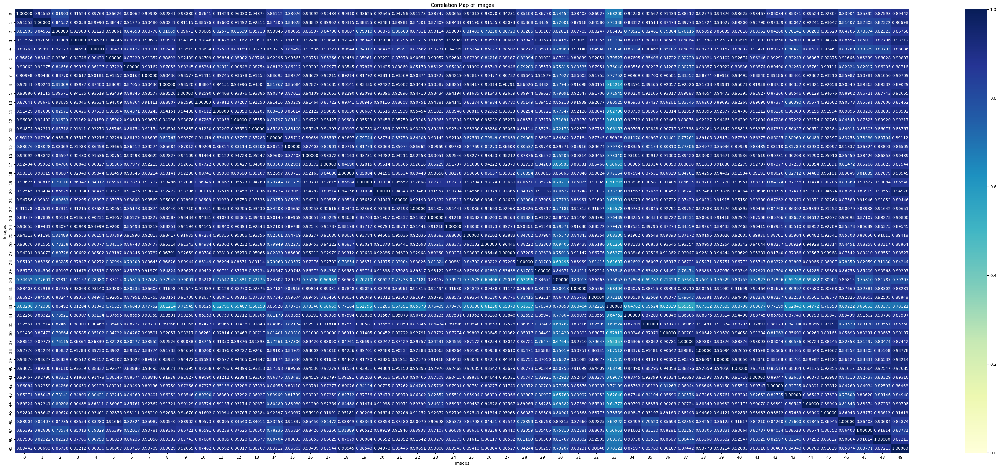

['/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_44/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_9/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_19/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_4/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_42/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_13/image0/0.jpg', '/home/dodo/ljx/BearRobot/data/libero/dataset/libero/data_jpg/libero_goal/push_the_plate_to_the_front_of_the_stove_demo/demo_47/image0/0.jpg', 

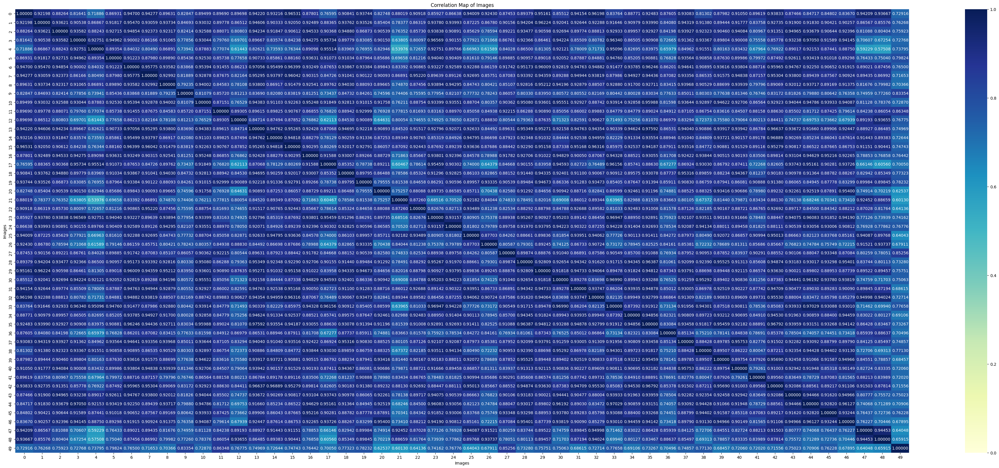

In [16]:
def get_img_of_instruction(Instruction):
    task = Instruction.replace(" ", "_")+ "_demo"
    demo_path_all = demo2frames.get_demos_for_task(task,frame_length_dict)
    begin_paths = [demo2frames.get_random_demo_img_path(demo_path,0,base_dir='/home/dodo/ljx/BearRobot/data/libero/dataset/') for demo_path in demo_path_all]
    begin_images = [Image.open(begin_path) for begin_path in begin_paths]
    end_paths = [demo2frames.get_random_demo_img_path(demo_path,frame_length_dict[demo_path]-1,base_dir='/home/dodo/ljx/BearRobot/data/libero/dataset/') for demo_path in demo_path_all]
    end_images = [Image.open(end_path) for end_path in end_paths]
    
    print(begin_paths)
    print(end_paths)
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    begin_images_tensor = torch.cat([transform(image).unsqueeze(0).unsqueeze(0) for image in begin_images], dim=1).squeeze(0)
    end_images_tensor = torch.cat([transform(image).unsqueeze(0).unsqueeze(0) for image in end_images], dim=1).squeeze(0)
    return begin_images_tensor, end_images_tensor

for Instruction in Instruction_list:
# Instruction = Instruction_list[5]
    begin, end = get_img_of_instruction(Instruction)
    with torch.no_grad():
        img_feature_begin = model.encode_image(begin)
        img_feature_end = model.encode_image(end)
        # correlation_matrix_map(img_feature_begin,"Image_same_demo")
        # correlation_matrix_map(img_feature_end,"Image_same_demo")
        correlation_matrix_map(img_feature_end-img_feature_begin,"Image_same_demo")

In [14]:
# import torch
# import seaborn as sns
# import matplotlib.pyplot as plt
# import numpy as np
# import DecisionNCE
# import random
# import sys
# import torch.nn.functional as F
# sys.path.append('/home/dodo/wgm/CL/BearRobot/')
# sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/')
# sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/data/')
# sys.path.append('/home/dodo/wgm/CL/BearRobot/BearRobot/utils/')

# from data.libero.data_process import demo2frames 
# # from utils.dataset.dataloader import openimage
# from PIL import Image
# from torchvision import transforms

# frame_length_dict = demo2frames.frame_counts_dict()


# def load_model():
#     device = "cuda" if torch.cuda.is_available() else "cpu"
#     model = DecisionNCE.load("DecisionNCE-T_libero_20ep", device=device)
#     # model = DecisionNCE.load("DecisionNCE-T_epick", device=device)
#     # model = DecisionNCE.load("DecisionNCE-T_openx_epic_libero_300ep", device=device)
#     # model = DecisionNCE.load("DecisionNCE-T_openx_epic_libero_3W", device=device)
#     # model = DecisionNCE.load("DecisionNCE-T_openx_epic", device=device)
#     # model = DecisionNCE.load("DecisionNCE-P", device=device)
#     return model

def bear_cosine_similarity(x, y):
    return torch.nn.functional.cosine_similarity(x, y, dim=-1)

# model = load_model()

['put the bowl on the plate']


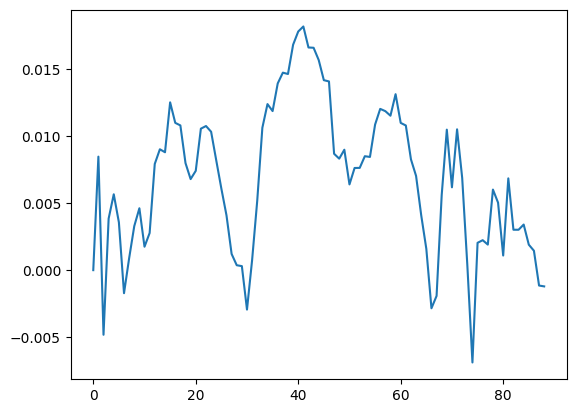

In [15]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

episode_path = "/data/libero/data_jpg/libero_goal/put_the_bowl_on_the_plate_demo/demo_49/image0"
episode_length = len(os.listdir(episode_path))

# image goal embedding
img_goal_idx = episode_length - 1
img_goal_path = os.path.join(episode_path, f"{img_goal_idx}.jpg")
img_goal = Image.open(img_goal_path)
img_goal_emb = model.encode_image(img_goal)

# image begin embedding
img_begin_path = os.path.join(episode_path, "0.jpg")
img_begin = Image.open(img_begin_path)
img_begin_emb = model.encode_image(img_begin)


instruction_path = os.path.join(episode_path, '../lang.txt')
with open(instruction_path, 'r') as f:
    instruction = f.readlines()
print(instruction)
lang_emb = model.encode_text(instruction)

sim_list = []
for idx in range(episode_length):
    image_path = os.path.join(episode_path, f"{idx}.jpg")
    image = Image.open(image_path)
    img_emb = model.encode_image(image)
    similarity = bear_cosine_similarity(lang_emb, img_emb-img_begin_emb)
    sim_list.append(similarity.detach().cpu().numpy())
    # print(similarity.item(), image_path)

sim_list_plot = np.array(sim_list)
plt.plot(sim_list_plot)

ImportError: cannot import name 'DecisionNCE_visual_diff' from 'BearRobot.Net.encoder.DecisionNCE' (/home/dodo/.zh1hao_space/BearRobot/BearRobot/Net/encoder/DecisionNCE.py)